In [1]:
import pickle
import pandas as pd
import cv2
import numpy as np

training_file = "DataSet/GermanTrafficSignals/TrafficSignsData/train.p"
test_file = "DataSet/GermanTrafficSignals/TrafficSignsData/test.p"
valid_file = "DataSet/GermanTrafficSignals/TrafficSignsData/valid.p"

with open(training_file, mode='rb') as file:
    train = pickle.load(file)
    
with open(test_file, mode='rb') as file:
    test = pickle.load(file)
    
with open(valid_file, mode='rb') as file:
    valid = pickle.load(file)


X_train, Y_train = train["features"], train["labels"]
X_test, Y_test = test["features"], test["labels"]
X_valid, Y_valid = valid["features"], valid["labels"]

series_labels_train = pd.Series(Y_train)

n_classes = series_labels_train.unique().size

print(X_train.shape)
print(X_test.shape)
print(X_valid.shape)
print (X_train.shape[1:-1])
print("Labels : {}".format(Y_train.shape[0]))
print (series_labels_train.unique().size)

    

(34799, 32, 32, 3)
(12630, 32, 32, 3)
(4410, 32, 32, 3)
(32, 32)
Labels : 34799
43


In [2]:

y_train_list = Y_train.tolist()
examples = range(n_classes)
examples = [y_train_list.index(index) for index in examples]
X_examples = [X_train[train_index] for train_index in examples]


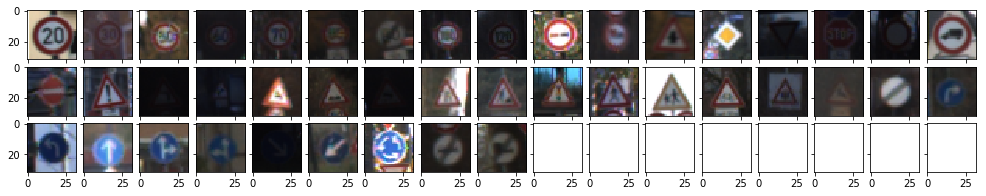

In [3]:
import matplotlib.pyplot as plt
import math
from mpl_toolkits.axes_grid1 import ImageGrid
%matplotlib inline


examples_length = len(X_examples)
n_cols = 0
if len(X_examples) > 10:
    n_cols = 11
n_cols = math.ceil(n_cols * 1.5)
n_rows = math.ceil(examples_length / n_cols)
fig1 = plt.figure(figsize=(n_cols, n_rows))
grid = ImageGrid(fig1, 111, nrows_ncols=(n_rows, n_cols), axes_pad=0.1)

for index, image in enumerate(X_examples):
    grid[index].imshow(image)
    
plt.show()


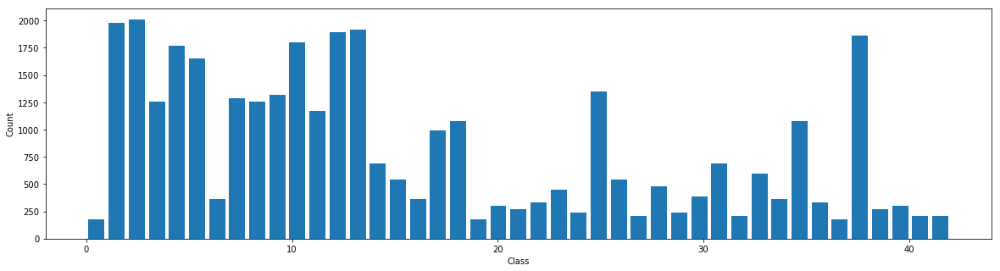

In [4]:
## Histogram of counts of each class
plt.figure(figsize=(20, 5))
bins = n_classes
plt.hist(y_train_list, n_classes, histtype='bar', rwidth=0.8)
plt.xlabel('Class')
plt.ylabel('Count')

In [5]:
single_label_indexes = list(series_labels_train[series_labels_train == 0].index)
images = [X_train[idx] for idx in single_label_indexes]
print (len(images))

180


In [6]:
import matplotlib.gridspec as gridspec

def plt_images_grid(images, grid_size = 2, figsize=2):
    grid_space = gridspec.GridSpec(grid_size,grid_size)
    grid_space.update(wspace=0.01, hspace=0.02) ## Set the spacing between the axis.
    plt.figure(figsize=(2,2))
    for i in range((grid_size * grid_size)):
        ax1 = plt.subplot(grid_space)
        ax1.set_xticklabels([])
        ax1.set_yticklabels([])
        ax1.set_aspect('equal')
        plt.subplot(10,10,i+1)
        plt.imshow(images[i])
        plt.axis('off')
    plt.show()

In [7]:

## Change brightness of the image using HSV
def augument_brightness_image(image):
    image_hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    ## Raise saturation and value components of HSV with in a range of 0.25 and 4. Multiply these values between 0.7 and 1.4 and add to them a value between -0.1 and 0.1
    rand_brightness_power = np.random.uniform(low=0.7, high=1.4)
    rand_addition = np.random.uniform(low=0, high=0.1)
    image_hsv[:,:,2] = image_hsv[:, :, 2]*rand_brightness_power
    image_hsv[:,:,2] = image_hsv[:,:,2] + rand_addition
    return cv2.cvtColor(image_hsv, cv2.COLOR_HSV2RGB)



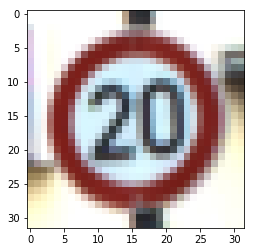

In [8]:
##gray_img = cv2.cvtColor(images[20], cv2.COLOR_RGB2GRAY)
plt.imshow(images[20])

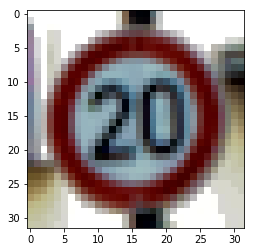

In [10]:
## Histogram equalization
def equalize_hist(img):
    img = cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    img_Y = img[:,:,0]
    img_Y = cv2.equalizeHist(img_Y)
    img[:,:,0] = img_Y
    img = cv2.cvtColor(img, cv2.COLOR_YCrCb2RGB)
    return img
    
img = equalize_hist(images[20])
plt.imshow(img)

In [24]:
## Explore Keras image generator

from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img


def image_data_generator(images, images_labels, prefix_label, stop_index):
    datagen = ImageDataGenerator(
            rotation_range=10,
            width_shift_range=0.2,
            height_shift_range=0.2,
            shear_range=0.2,
            zoom_range=0.2,
            horizontal_flip=False,
            rescale = 1/255,
            fill_mode='nearest')
    X_out = []
    Y_out = []
    img_id = -1
    for idx, image in enumerate(images):
        label = images_labels[idx]
        ##print (image.shape)
        img_id += 1
        x = img_to_array(image)
        x = x.reshape((1,) + x.shape)
        y = label.reshape((1,)+ label.shape)
        # the .flow() command below generates batches of randomly transformed images
        # and saves the results to the `preview/` directory
        i = 0
        prefix = prefix_label + '_sign' + str(img_id)
        for x_gen, y_gen in datagen.flow(x,y, batch_size=1,
                                  save_to_dir='tmpDatasetsPreview', save_prefix= prefix, save_format='jpeg'):
            i += 1
            x_gen = x_gen.reshape(32,32,3)
            X_out.append(x_gen)
            Y_out.append(y_gen)
            #brighten_img = augument_brightness_image(x_gen)
            #plt.imsave('brightness/' + prefix, brighten_img)
            if i > stop_index:
                break  # otherwise the generator would loop indefinitely
    return X_out, Y_out

In [ ]:
unique_labels_series = series_labels_train.unique()
#print(unique_labels_series)
for label in np.nditer(unique_labels_series):
    #print("Label: {}".format(label))
    single_label_indexes = list(series_labels_train[series_labels_train == label].index)
    images = []
    images_labels = []
    for idx in single_label_indexes:
        image = X_train[idx]
        image = equalize_hist(image)
        images.append(image)
        images_labels.append(Y_train[idx])
    prefix = 'Label_' + str(label)
    stop_index = 2200 - len(single_label_indexes)
    #print("Stop Index: {}".format(stop_index))
    stop_index = 5
    if (stop_index > 0):
        temp = image_data_generator(images, images_labels, prefix, stop_index)
        ##print ("Temp: {}{}".format(temp[0], temp[1]))
        
    

(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32, 32, 3)
(32,